In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas
import folium
from folium.plugins import FastMarkerCluster
from datetime import datetime
import plotly.express as px

%reload_ext autoreload
%autoreload 2

sns.set_palette("Set2")

In [2]:
calendar_18_csv = r'D:\Notes\Mini Project 1\Airbnb Sydney open data\calendar_dec18.csv'
calendar_18_0= pd.read_csv(calendar_18_csv)
calendar_18_0.head(5)

,listing_id,date,available,price
0,14250,2019-12-06,t,$470.00
1,12351,2019-08-17,t,$110.00
2,12351,2019-08-16,t,$110.00
3,12351,2019-08-15,t,$110.00
4,12351,2019-08-14,t,$110.00


In [3]:
calendar_18_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13381265 entries, 0 to 13381264
Data columns (total 4 columns):
 #   Column      Dtype 
---  ------      ----- 
 0   listing_id  int64 
 1   date        object
 2   available   object
 3   price       object
dtypes: int64(1), object(3)
memory usage: 408.4+ MB


In [4]:
calendar_21_csv = r'D:\Notes\Mini Project 1\Airbnb Sydney open data\calendar_dec21.csv'
calendar_21_0= pd.read_csv(calendar_21_csv)
calendar_21_0.price = calendar_21_0.adjusted_price
#calendar_21_0.price = calendar_21_0['price'].astype(str)
calendar_21_0.head(5)

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,35350679,2021-12-08,f,$500.00,$500.00,2.0,30.0
1,11156,2021-12-08,f,$65.00,$65.00,90.0,180.0
2,11156,2021-12-09,t,$65.00,$65.00,90.0,180.0
3,11156,2021-12-10,t,$65.00,$65.00,90.0,180.0
4,11156,2021-12-11,t,$65.00,$65.00,90.0,180.0


In [5]:
calendar_21_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7621196 entries, 0 to 7621195
Data columns (total 7 columns):
 #   Column          Dtype  
---  ------          -----  
 0   listing_id      int64  
 1   date            object 
 2   available       object 
 3   price           object 
 4   adjusted_price  object 
 5   minimum_nights  float64
 6   maximum_nights  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 407.0+ MB


In [6]:
def calendar_m_year(calendar):
    calendar['listing_id'] = calendar['listing_id'].astype(str)
    calendar['date'] = pd.to_datetime(calendar.date)
    calendar['price'] = calendar['price'].str.replace('$', '')
    calendar['price'] = calendar['price'].str.replace(',', '')
    calendar['price'] = calendar['price'].astype(float)
    calendar.dropna(subset = ['price', 'listing_id'], how='any', axis = 0)
    print('calendar dataset including the price listing from ', calendar.date.min(),' to ', calendar.date.max())    
    calendar = calendar[calendar.available == 't']
    calendar['year'] = pd.DatetimeIndex(calendar['date']).year
    calendar['month'] = pd.DatetimeIndex(calendar['date']).month
    calendar['month_name'] = pd.DatetimeIndex(calendar['date']).month_name()
    calendar['mm-year'] = calendar['month_name'].str[:3] +'-'+ calendar['year'].astype(str).str[2:]
    #calendar.price = calendar.price.round(decimals=2)
    group_by = ['listing_id','mm-year']
    agg_by = {'price': 'mean'}
    calendar_groupby_id = calendar.groupby(by=group_by).agg(agg_by)
    calendar_groupby_id.price = calendar_groupby_id.price.round(decimals=2)
    calendar_0 = calendar_groupby_id.reset_index()
    calendar_1 = pd.pivot(calendar_0, index='listing_id',  columns ='mm-year').droplevel(level=0, axis=1)
    #calendar_2 = pd.melt(calendar_1, id_vars='mm-year')
    return calendar_1

In [7]:
calendar_21_m_y = calendar_m_year(calendar_21_0)
calendar_18_m_y = calendar_m_year(calendar_18_0)

C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:4: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  calendar['price'] = calendar['price'].str.replace('$', '')


calendar dataset including the price listing from  2021-12-07 00:00:00  to  2022-12-07 00:00:00


C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  calendar['year'] = pd.DatetimeIndex(calendar['date']).year
C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  calendar['month'] = pd.DatetimeIndex(calendar['date']).month
C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

calendar dataset including the price listing from  2018-12-07 00:00:00  to  2019-12-06 00:00:00


C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  calendar['year'] = pd.DatetimeIndex(calendar['date']).year
C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  calendar['month'] = pd.DatetimeIndex(calendar['date']).month
C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1888326927.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

In [8]:
calendar_21_m_y.head(3)

mm-year,Apr-22,Aug-22,Dec-21,Dec-22,Feb-22,Jan-22,Jul-22,Jun-22,Mar-22,May-22,Nov-22,Oct-22,Sep-22
listing_id,,,,,,,,,,,,,
10007550,NaN,NaN,250.0,NaN,250.0,250.0,NaN,NaN,250.0,NaN,NaN,NaN,NaN
10021297,NaN,NaN,55.0,NaN,55.0,55.0,NaN,NaN,55.0,NaN,NaN,NaN,NaN
1002247,150.0,150.0,190.0,150.0,150.0,187.1,150.0,150.0,150.0,150.0,150.0,150.0,150.0


In [9]:
# get listing data for analysis

In [10]:
listing_18_csv = r'D:\Notes\Mini Project 1\Airbnb Sydney open data\listings_summary_dec18.csv'
listing_18 = pd.read_csv(listing_18_csv)

In [11]:
listing_21_csv = r'D:\Notes\Mini Project 1\Airbnb Sydney open data\listings_summary_dec21.csv'
listing_21 = pd.read_csv(listing_21_csv)

In [12]:
# clean listing dataset funciton
def listing_clean(data):
    data['id'] = data['id'].astype(str)
    data['host_id'] = data['host_id'].astype(str)
    data.last_review = pd.to_datetime(data.last_review, format='%Y/%m/%d')
    data = data.drop(columns=['neighbourhood_group'])  #empty column
    data['availability_perc'] = data['availability_365']/365
    print('Number of Sydney Airbnb Listings:', data.shape[0])
    print('Number of features in dataset:', data.shape[1])
    print('Avarage price is : $',round(data.price.mean()))
    print('Number of hosts/suppliers: ', data.host_id.nunique())
    print('Number of suburbs: ', data.neighbourhood.nunique())
    return data

In [13]:
listing_18 = listing_clean(listing_18)
listing_18.head(5)

Number of Sydney Airbnb Listings: 36662
Number of features in dataset: 16
Avarage price is : $ 208
Number of hosts/suppliers:  27219
Number of suburbs:  38


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,availability_perc
0,12351,Sydney City & Harbour at the door,17061,Stuart,Sydney,-33.865153,151.191896,Private room,100,2,493,2018-11-21,4.83,2,187,0.512329
1,14250,Manly Harbour House,55948,Heidi,Manly,-33.800929,151.261722,Entire home/apt,471,5,1,2016-01-02,0.03,2,321,0.879452
2,15253,Stunning Penthouse Apartment In Heart Of The City,59850,Morag,Sydney,-33.880455,151.216541,Private room,109,2,300,2018-11-16,3.63,2,316,0.865753
3,20865,3 BED HOUSE + 1 BED STUDIO Balmain,64282,Fiona,Leichhardt,-33.859072,151.172753,Entire home/apt,450,7,15,2018-01-07,0.18,1,69,0.189041
4,26174,"COZY PRIVATE ROOM, GREAT LOCATION!",110561,Amanda,Woollahra,-33.889087,151.259404,Private room,62,1,42,2018-11-23,0.45,1,140,0.383562


In [14]:
listing_21 = listing_clean(listing_21)
listing_21.head(5)

Number of Sydney Airbnb Listings: 20880
Number of features in dataset: 18
Avarage price is : $ 251
Number of hosts/suppliers:  15115
Number of suburbs:  38


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,availability_perc
0,11156,An Oasis in the City,40855,Colleen,Sydney,-33.86767,151.22497,Private room,65,90,196,2020-03-13,1.34,1,364,0,NaN,0.997260
1,14250,Manly Harbour House,55948,Heidi,Manly,-33.80084,151.26378,Entire home/apt,470,2,3,2021-06-01,0.04,2,174,1,Exempt,0.476712
2,15253,Unique Designer Rooftop Apartment in City Loca...,59850,Morag,Sydney,-33.87964,151.21680,Private room,82,2,383,2021-12-03,3.21,1,336,18,PID-STRA-24061-7,0.920548
3,44545,Sunny Darlinghurst Warehouse Apartment,112237,Atari,Sydney,-33.87888,151.21439,Entire home/apt,130,90,76,2020-01-03,0.56,1,0,0,NaN,0.000000
4,58506,"Studio Yindi @ Mosman, Sydney",279955,John,Mosman,-33.81748,151.23484,Entire home/apt,150,2,297,2021-11-30,2.23,1,217,15,PID-STRA-6093,0.594521


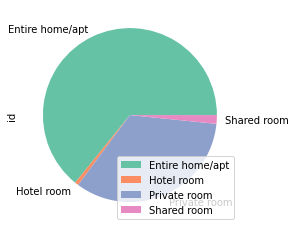

In [15]:
listing_21.groupby(['room_type']).count().plot(kind='pie', y='id')
plt.legend(loc = 'lower right')
plt.show()

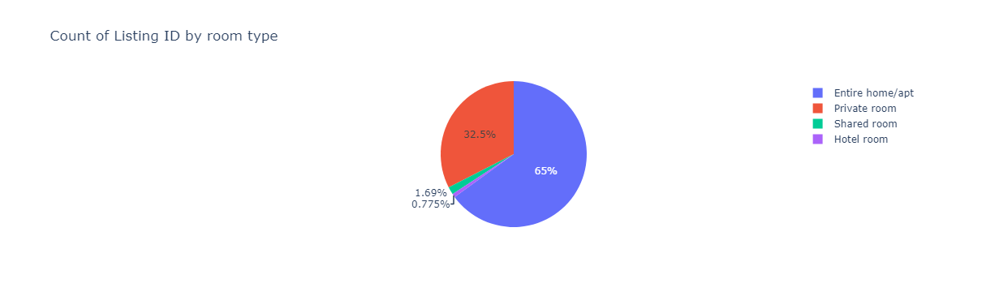

In [16]:
fig = px.pie(listing_21, values='id', names = 'room_type', title = 'Count of Listing ID by room type')
fig.show()

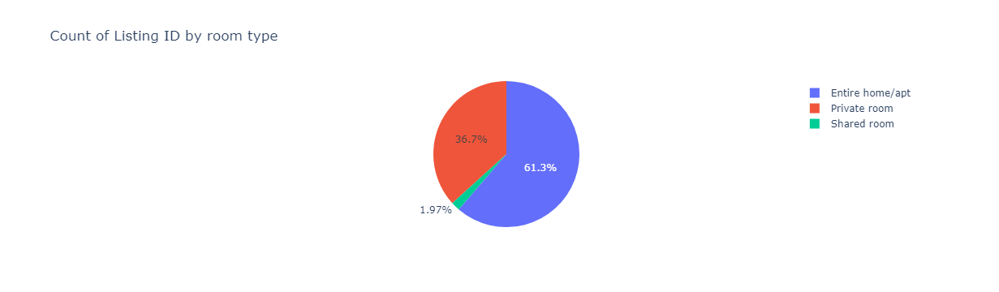

In [17]:
fig = px.pie(listing_18, values='id', names = 'room_type', title = 'Count of Listing ID by room type')
fig.show()

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:ylabel='Density'>

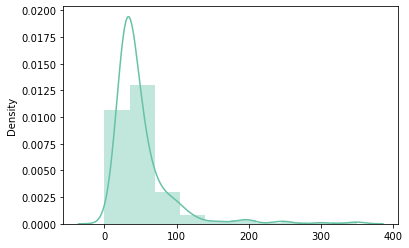

In [18]:
condition_18_3 = listing_18.room_type == 'Shared room'
condition_18_4 = listing_18.price <400
listing_18_2 = listing_18[condition_18_3 & condition_18_4]

sns.distplot(x= listing_18_2['price'], bins=10)

In [19]:
def distplot_show(data,room_type, price_ceil,n):
    # n : bins
    condition_a = data.room_type == room_type
    condition_b = data.price < price_ceil
    data = data[condition_a & condition_b]
    sns.distplot(x= data['price'], bins=n)
    plt.show()

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



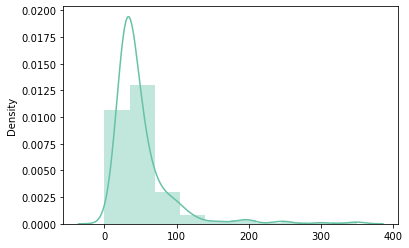

In [20]:
distplot_show(listing_18,'Shared room',400,n=10)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



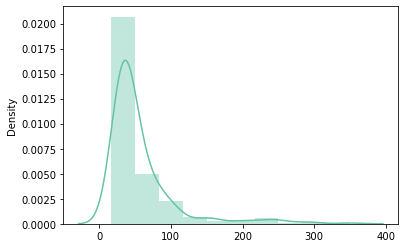

In [21]:
distplot_show(listing_21,'Shared room',400,n=10)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



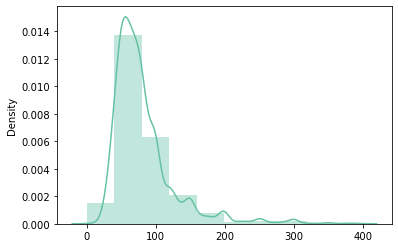

In [22]:
distplot_show(listing_18,'Private room',400,n=10)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



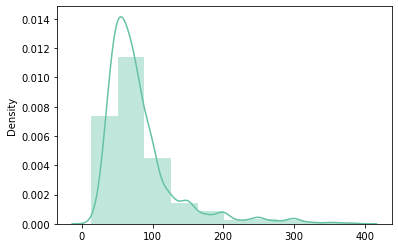

In [23]:
distplot_show(listing_21,'Private room',400,n=10)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



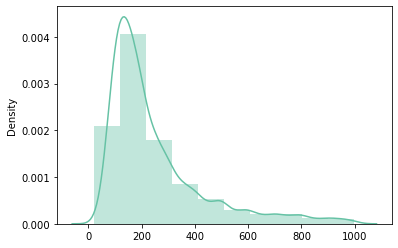

In [24]:
distplot_show(listing_21,'Entire home/apt',1000,n=10)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



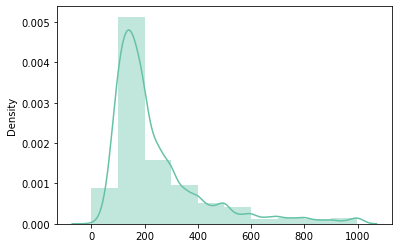

In [25]:
distplot_show(listing_18,'Entire home/apt',1000,n=10)

In [26]:
merged_18 = listing_18.merge(calendar_18_m_y, left_on= 'id', right_on= 'listing_id', how = 'left')
merged_18.head(5)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,...,Dec-19,Feb-19,Jan-19,Jul-19,Jun-19,Mar-19,May-19,Nov-19,Oct-19,Sep-19
0,12351,Sydney City & Harbour at the door,17061,Stuart,Sydney,-33.865153,151.191896,Private room,100,2,...,NaN,106.31,101.67,110.00,108.93,99.56,103.17,NaN,NaN,110.00
1,14250,Manly Harbour House,55948,Heidi,Manly,-33.800929,151.261722,Entire home/apt,471,5,...,470.00,470.00,470.00,470.00,470.00,470.00,470.00,470.00,470.00,470.00
2,15253,Stunning Penthouse Apartment In Heart Of The City,59850,Morag,Sydney,-33.880455,151.216541,Private room,109,2,...,111.67,113.00,112.22,112.58,113.00,112.86,112.90,113.33,112.58,112.67
3,20865,3 BED HOUSE + 1 BED STUDIO Balmain,64282,Fiona,Leichhardt,-33.859072,151.172753,Entire home/apt,450,7,...,458.33,NaN,461.76,475.00,NaN,NaN,NaN,466.67,458.33,NaN
4,26174,"COZY PRIVATE ROOM, GREAT LOCATION!",110561,Amanda,Woollahra,-33.889087,151.259404,Private room,62,1,...,NaN,62.00,65.00,NaN,62.00,62.00,62.00,NaN,NaN,NaN


In [27]:
merged_21 = listing_18.merge(calendar_18_m_y, left_on= 'id', right_on= 'listing_id', how = 'left')
merged_21.head(5)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,...,Dec-19,Feb-19,Jan-19,Jul-19,Jun-19,Mar-19,May-19,Nov-19,Oct-19,Sep-19
0,12351,Sydney City & Harbour at the door,17061,Stuart,Sydney,-33.865153,151.191896,Private room,100,2,...,NaN,106.31,101.67,110.00,108.93,99.56,103.17,NaN,NaN,110.00
1,14250,Manly Harbour House,55948,Heidi,Manly,-33.800929,151.261722,Entire home/apt,471,5,...,470.00,470.00,470.00,470.00,470.00,470.00,470.00,470.00,470.00,470.00
2,15253,Stunning Penthouse Apartment In Heart Of The City,59850,Morag,Sydney,-33.880455,151.216541,Private room,109,2,...,111.67,113.00,112.22,112.58,113.00,112.86,112.90,113.33,112.58,112.67
3,20865,3 BED HOUSE + 1 BED STUDIO Balmain,64282,Fiona,Leichhardt,-33.859072,151.172753,Entire home/apt,450,7,...,458.33,NaN,461.76,475.00,NaN,NaN,NaN,466.67,458.33,NaN
4,26174,"COZY PRIVATE ROOM, GREAT LOCATION!",110561,Amanda,Woollahra,-33.889087,151.259404,Private room,62,1,...,NaN,62.00,65.00,NaN,62.00,62.00,62.00,NaN,NaN,NaN


In [28]:
merged_21.describe

<bound method NDFrame.describe of              id                                               name    host_id  \
0         12351                  Sydney City & Harbour at the door      17061   
1         14250                                Manly Harbour House      55948   
2         15253  Stunning Penthouse Apartment In Heart Of The City      59850   
3         20865                 3 BED HOUSE + 1 BED STUDIO Balmain      64282   
4         26174                 COZY PRIVATE ROOM, GREAT LOCATION!     110561   
...         ...                                                ...        ...   
36657  30592081                             The top floor paradise  229475098   
36658  30592161   Sydney harbour catamaran sailing. Parties for 10  223580521   
36659  30592248  Double Room built-in a large and bright apartment  119396721   
36660  30592505     Bright Modern apartment in a Premiere location  229479027   
36661  30593866   Huge Sunny Double Room with Spa in Best Location   511380

In [29]:
review_18_csv = r'D:\Notes\Mini Project 1\Airbnb Sydney open data\reviews_dec18.csv'
review_18_0 = pd.read_csv(review_18_csv)
review_18_0['date'] = pd.to_datetime(review_18_0.date)
review_18_0 = review_18_0[review_18_0['date']> '2018-12-07'] # listing and calenda data start from 07-dec
review_18_0.head(3)

,listing_id,id,date,reviewer_id,reviewer_name,comments


In [30]:
review_21_csv = r'D:\Notes\Mini Project 1\Airbnb Sydney open data\reviews_dec21.csv'
review_21_0 = pd.read_csv(review_21_csv)
review_21_0 = review_18_0[review_21_0['date']> '2021-12-07'] # listing and calenda data start from 07-dec
review_21_0.head(3)

C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1963436610.py:3: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,listing_id,id,date,reviewer_id,reviewer_name,comments


In [31]:
review_21_0.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 0 entries
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   listing_id     0 non-null      int64         
 1   id             0 non-null      int64         
 2   date           0 non-null      datetime64[ns]
 3   reviewer_id    0 non-null      int64         
 4   reviewer_name  0 non-null      object        
 5   comments       0 non-null      object        
dtypes: datetime64[ns](1), int64(3), object(2)
memory usage: 0.0+ bytes


In [32]:
review_21_0['date'] = pd.to_datetime(review_21_0.date)
review_21_0['year'] = pd.DatetimeIndex(review_21_0['date']).year
review_21_0.head(3)

,listing_id,id,date,reviewer_id,reviewer_name,comments,year


In [33]:
def review_clean(review):
    # clean review dataset, show the data as the number of reviews by month name
    review['listing_id'] = review['listing_id'].astype(str)
    review['date'] = pd.to_datetime(review.date)
    review['year'] = pd.DatetimeIndex(review['date']).year
    review['month'] = pd.DatetimeIndex(review['date']).month
    review['month_name'] = pd.DatetimeIndex(review['date']).month_name()
    review['mm-year'] = review['month_name'].str[:3] +'-'+ review['year'].astype(str).str[2:]
    group_by = ['listing_id','mm-year']
    agg_by = {'comments': 'count'}
    review_groupby_id = review.groupby(by=group_by).agg(agg_by)
    review_0 = review_groupby_id.reset_index()
    review_1 = pd.pivot(review_0, index='listing_id',  columns ='mm-year').droplevel(level=0, axis=1)
    return review_1

In [34]:
review_18_1 = review_clean(review_18_0)
review_18_1.head(3)

mm-year
listing_id


In [35]:
review_21_1 = review_clean(review_21_0)
review_21_1.head(3)

mm-year
listing_id


def calendar_m_year(calendar):
    calendar['listing_id'] = calendar['listing_id'].astype(str)
    calendar['date'] = pd.to_datetime(calendar.date)
    calendar['price'] = calendar['price'].str.replace('$', '')
    calendar['price'] = calendar['price'].str.replace(',', '')
    calendar['price'] = calendar['price'].astype(float)
    calendar.dropna(subset = ['price', 'listing_id'], how='any', axis = 0)
    print('calendar dataset including the price listing from ', calendar.date.min(),' to ', calendar.date.max())    
    calendar = calendar[calendar.available == 't']
    calendar['year'] = pd.DatetimeIndex(calendar['date']).year
    calendar['month'] = pd.DatetimeIndex(calendar['date']).month
    calendar['month_name'] = pd.DatetimeIndex(calendar['date']).month_name()
    calendar['mm-year'] = calendar['month_name'].str[:3] +'-'+ calendar['year'].astype(str).str[2:]
    #calendar.price = calendar.price.round(decimals=2)
    group_by = ['listing_id','mm-year']
    agg_by = {'price': 'mean'}
    calendar_groupby_id = calendar.groupby(by=group_by).agg(agg_by)
    calendar_groupby_id.price = calendar_groupby_id.price.round(decimals=2)
    calendar_0 = calendar_groupby_id.reset_index()
    calendar_1 = pd.pivot(calendar_0, index='listing_id',  columns ='mm-year').droplevel(level=0, axis=1)
    #calendar_2 = pd.melt(calendar_1, id_vars='mm-year')
    return calendar_1

# Business Questions

In [36]:
from scipy import stats

In [37]:
listing_18.head(3)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,availability_perc
0,12351,Sydney City & Harbour at the door,17061,Stuart,Sydney,-33.865153,151.191896,Private room,100,2,493,2018-11-21,4.83,2,187,0.512329
1,14250,Manly Harbour House,55948,Heidi,Manly,-33.800929,151.261722,Entire home/apt,471,5,1,2016-01-02,0.03,2,321,0.879452
2,15253,Stunning Penthouse Apartment In Heart Of The City,59850,Morag,Sydney,-33.880455,151.216541,Private room,109,2,300,2018-11-16,3.63,2,316,0.865753


In [38]:
listing_18.shape

(36662, 16)

In [39]:
listing_21.head(3)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,availability_perc
0,11156,An Oasis in the City,40855,Colleen,Sydney,-33.86767,151.22497,Private room,65,90,196,2020-03-13,1.34,1,364,0,NaN,0.997260
1,14250,Manly Harbour House,55948,Heidi,Manly,-33.80084,151.26378,Entire home/apt,470,2,3,2021-06-01,0.04,2,174,1,Exempt,0.476712
2,15253,Unique Designer Rooftop Apartment in City Loca...,59850,Morag,Sydney,-33.87964,151.21680,Private room,82,2,383,2021-12-03,3.21,1,336,18,PID-STRA-24061-7,0.920548


In [40]:
listing_21.shape

(20880, 18)

# 1 is there any difference in the price between "period from dec18-dec19" and "period from dec21-dec22"

In [41]:
null_hypothesis_1 = {
    'H0': "There is no difference in the price between 2018 listings and 2021 listings",
    'H1': "There is a difference in the price between 2018 listings and 2021 listings."
}

In [42]:
null_hypothesis_1

{'H0': 'There is no difference in the price between 2018 listings and 2021 listings',
 'H1': 'There is a difference in the price between 2018 listings and 2021 listings.'}

In [43]:
alpha = 0.05
N = 100

In [44]:
listing_21_price_1 = listing_21['price'].sample(N, random_state = 42)
listing_21_price_1

2119     100
13238     85
18391     65
19539    279
6534      95
        ... 
17651     51
16597    279
19745    163
14371    150
8442     270
Name: price, Length: 100, dtype: int64

In [45]:
listing_18_price_1 = listing_18['price'].sample(N, random_state = 42)
listing_18_price_1

11857    228
4305      65
24257     46
28040     80
273       53
        ... 
23358    116
7600      84
23257    100
35474    500
5883     140
Name: price, Length: 100, dtype: int64

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



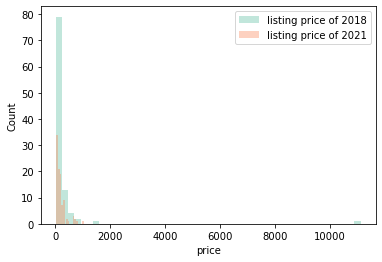

In [46]:
ax = sns.distplot(listing_18_price_1, label ='listing price of 2018', kde = False);
sns.distplot(listing_21_price_1, ax = ax,  label = 'listing price of 2021', kde = False);
plt.legend(loc = 'upper right')
plt.xlabel('price')
plt.ylabel('Count')
plt.show();# put on same charts

In [47]:
def print_sig(p_value, alpha,null_hypothesis):
    '''
    Inputs:
    p_value: Calculated p_value
    alpha: Confidence level
    '''
    if p_value < alpha:
        print("We reject our null hypothesis,accept H1 statement")
        print(null_hypothesis['H1'])
    elif p_value > alpha:
        print("We fail to reject our null hypothesis, accept H0 statement")
        print(null_hypothesis['H0'])
    else:
        print("Our test is inconclusive.")

In [48]:
t1, p1 = stats.ttest_ind(listing_21_price_1, listing_18_price_1)
print("t = " + str(t1))
print("p = " + str(p1))
print_sig(p1, alpha,null_hypothesis_1)

t = -0.9143260108128004
p = 0.36165765398887806
We fail to reject our null hypothesis, accept H0 statement
There is no difference in the price between 2018 listings and 2021 listings


# 2. for merged data set, is there any difference in price between 2018 and 2021?

In [49]:
null_hypothesis_2 = {
    'H0': "There is no difference in the price between 2018 listings and 2021 listings",
    'H1': "There is a difference in the price between 2018 listings and 2021 listings."
}

In [50]:
listing_18_2 = listing_18[['id', 'price']]
listing_18_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36662 entries, 0 to 36661
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      36662 non-null  object
 1   price   36662 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 573.0+ KB


In [51]:
listing_21_2 = listing_21[['id', 'price']]
listing_21_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20880 entries, 0 to 20879
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      20880 non-null  object
 1   price   20880 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 326.4+ KB


In [52]:
listing_merge2 = pd.merge(left = listing_18_2, right = listing_21_2, left_on = 'id', right_on = 'id', suffixes = ('_18','_21'))
listing_merge2.head(2)

,id,price_18,price_21
0,14250,471,470
1,15253,109,82


In [53]:
listing_merge2['price_dif'] = listing_merge2['price_21'] - listing_merge2['price_18']
listing_merge2.describe()

,price_18,price_21,price_dif
count,10998.000000,10998.000000,10998.000000
mean,206.528369,228.729496,22.201127
std,308.757103,478.979914,387.088103
min,0.000000,13.000000,-8161.000000
25%,80.000000,80.000000,-5.000000
50%,136.000000,135.000000,0.000000
75%,226.000000,240.000000,9.000000
max,12000.000000,28613.000000,28553.000000


In [54]:
listing_merge2.median()

id           16410897.5
price_18          136.0
price_21          135.0
price_dif           0.0
dtype: float64

In [55]:
listing_merge2.shape

(10998, 4)

In [56]:
listing_18_2m = listing_merge2[['price_18']].sample(N, random_state = 42)

In [57]:
listing_21_2m = listing_merge2[['price_21']].sample(N, random_state = 42)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



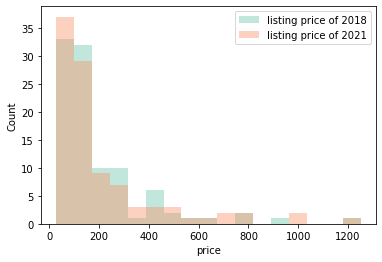

In [58]:
ax = sns.distplot(listing_18_2m, label ='listing price of 2018', kde = False);
sns.distplot(listing_21_2m, ax = ax,  label = 'listing price of 2021', kde = False);
plt.legend(loc = 'upper right')
plt.xlabel('price')
plt.ylabel('Count')
plt.show();# put on same charts

In [59]:
t2, p2 = stats.ttest_ind(listing_18_2m, listing_21_2m)
print("t = " + str(t2))
print("p = " + str(p2))
print_sig(p2, alpha,null_hypothesis_2)

t = [-0.48977309]
p = [0.62483668]
We fail to reject our null hypothesis, accept H0 statement
There is no difference in the price between 2018 listings and 2021 listings


# 3. For Entire home listings, is there any difference in price between 2018 and 2021?

In [60]:
null_hypothesis_3 = {
    'H0': "There is no difference in the price between 2018 listings and 2021 listings for entire home listings",
    'H1': "There is a difference in the price between 2018 listings and 2021 listings for entire home listings."
}

In [61]:
listing_18_3 = listing_18[['id', 'price', 'room_type']]
listing_18_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36662 entries, 0 to 36661
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         36662 non-null  object
 1   price      36662 non-null  int64 
 2   room_type  36662 non-null  object
dtypes: int64(1), object(2)
memory usage: 859.4+ KB


In [62]:
listing_21_3 = listing_21[['id', 'price', 'room_type']]
listing_21_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20880 entries, 0 to 20879
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         20880 non-null  object
 1   price      20880 non-null  int64 
 2   room_type  20880 non-null  object
dtypes: int64(1), object(2)
memory usage: 489.5+ KB


In [63]:
listing_18_3_p = listing_18_3[listing_18_3['room_type'] == 'Entire home/apt']['price'].sample(N, random_state = 42)
listing_21_3_p = listing_21_3[listing_21_3['room_type'] == 'Entire home/apt']['price'].sample(N, random_state = 42)

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



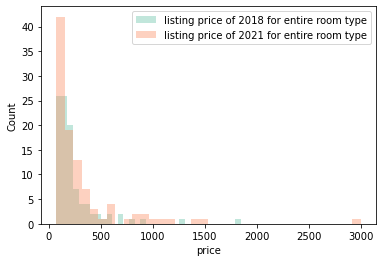

In [64]:
ax = sns.distplot(listing_18_3_p, label ='listing price of 2018 for entire room type', kde = False);
sns.distplot(listing_21_3_p, ax = ax,  label = 'listing price of 2021 for entire room type', kde = False);
plt.legend(loc = 'upper right')
plt.xlabel('price')
plt.ylabel('Count')
plt.show();# put on same charts

In [65]:
t3, p3 = stats.ttest_ind(listing_18_3_p, listing_21_3_p)
print("t = " + str(t3))
print("p = " + str(p3))
print_sig(p3, alpha,null_hypothesis_3)

t = -1.4990692055535604
p = 0.13544837226885142
We fail to reject our null hypothesis, accept H0 statement
There is no difference in the price between 2018 listings and 2021 listings for entire home listings


# 4. For Non-ntire home listings, is there any difference in price between 2018 and 2021?

In [66]:
null_hypothesis_4 = {
    'H0': "There is no difference in the price between 2018 listings and 2021 listings for Non-entire home listings",
    'H1': "There is a difference in the price between 2018 listings and 2021 listings for Non-entire home listings."
}

In [67]:
listing_18_4 = listing_18[['id', 'price', 'room_type']]
listing_18_4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36662 entries, 0 to 36661
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         36662 non-null  object
 1   price      36662 non-null  int64 
 2   room_type  36662 non-null  object
dtypes: int64(1), object(2)
memory usage: 859.4+ KB


In [68]:
listing_21_4 = listing_21[['id', 'price', 'room_type']]
listing_21_4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20880 entries, 0 to 20879
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         20880 non-null  object
 1   price      20880 non-null  int64 
 2   room_type  20880 non-null  object
dtypes: int64(1), object(2)
memory usage: 489.5+ KB


In [69]:
listing_18_4_p= listing_18_4[(listing_18_4['room_type'] =='Private room')|(listing_18_4['room_type'] == 'Shared room')]['price'].sample(N, random_state = 42)
listing_21_4_p= listing_21_4[(listing_21_4['room_type'] =='Private room')|(listing_21_4['room_type'] == 'Shared room')]['price'].sample(N, random_state = 42)

In [70]:
listing_18_4_p

32952     46
23901    100
11686    100
9385      60
10603     55
        ... 
19573     90
6180      39
24914     65
1898     165
3205      46
Name: price, Length: 100, dtype: int64

In [71]:
listing_21_4_p

15032    129
7579      44
1650     300
8543      70
14478    170
        ... 
8448      70
3742     240
18305     70
19512     56
5669      68
Name: price, Length: 100, dtype: int64

C:\Users\Clivia\Anaconda3-2019.10\envs\IOD\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



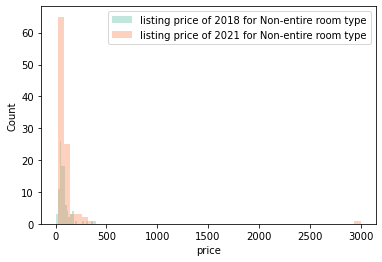

In [72]:
ax = sns.distplot(listing_18_4_p, label ='listing price of 2018 for Non-entire room type', kde = False);
sns.distplot(listing_21_4_p, ax = ax,  label = 'listing price of 2021 for Non-entire room type', kde = False);
plt.legend(loc = 'upper right')
plt.xlabel('price')
plt.ylabel('Count')
plt.show();# put on same charts

In [73]:
t4, p4 = stats.ttest_ind(listing_18_4_p, listing_21_4_p)
print("t = " + str(t4))
print("p = " + str(p4))
print_sig(p4, alpha,null_hypothesis_4)

t = -0.8975420201617832
p = 0.3705198199395001
We fail to reject our null hypothesis, accept H0 statement
There is no difference in the price between 2018 listings and 2021 listings for Non-entire home listings


# 5. Is there any difference in the price between “Period from Dec17- Dec18” and “Period from Dec20-Dec21” for each region groups

In [74]:
url_full = 'https://sydneysuburbreviews.com/suburb-rankings/'
tables = pd.read_html(url_full)
table = tables[0]
table = table[['Name','Region']]
table.shape

(421, 2)

In [75]:
def clean_column_name(column_names):
    clean_column_names = []
    for c in column_names:
        c = c.lower().replace(' ', '_')
        c = c.lower().replace('*', '')
        c = c.lower().replace('?', '')
        clean_column_names.append(c)
    return clean_column_names

In [76]:
listing_18.neighbourhood = clean_column_name(listing_18.neighbourhood)
listing_21.neighbourhood = clean_column_name(listing_21.neighbourhood)
table.Name = clean_column_name(table.Name)
table.Name

C:\Users\Clivia\AppData\Local\Temp\ipykernel_21812\1734824492.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0           hornsby
1            oatley
2      dulwich_hill
3           jannali
4          waverton
           ...     
416         yagoona
417     yarrawarrah
418         yennora
419       yowie_bay
420    bexley_north
Name: Name, Length: 421, dtype: object

In [77]:
table

,Name,Region
0,hornsby,Upper North Shore
1,oatley,Southern Suburbs
2,dulwich_hill,Inner West
3,jannali,Sutherland Shire
4,waverton,Lower North Shore
...,...,...
416,yagoona,Western Suburbs
417,yarrawarrah,Sutherland Shire
418,yennora,Western Suburbs
419,yowie_bay,Sutherland Shire


In [78]:
table[table.Name == 'manly']

,Name,Region
34,manly,Northern Beaches


In [79]:
listing_18 = listing_18.merge(table, left_on= 'neighbourhood', right_on= 'Name', how = 'left')
listing_18.head(3)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,availability_perc,Name,Region
0,12351,Sydney City & Harbour at the door,17061,Stuart,sydney,-33.865153,151.191896,Private room,100,2,493,2018-11-21,4.83,2,187,0.512329,NaN,NaN
1,14250,Manly Harbour House,55948,Heidi,manly,-33.800929,151.261722,Entire home/apt,471,5,1,2016-01-02,0.03,2,321,0.879452,manly,Northern Beaches
2,15253,Stunning Penthouse Apartment In Heart Of The City,59850,Morag,sydney,-33.880455,151.216541,Private room,109,2,300,2018-11-16,3.63,2,316,0.865753,NaN,NaN


In [80]:
listing_21 = listing_21.merge(table, left_on= 'neighbourhood', right_on= 'Name', how = 'left')
listing_21.head(3)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,availability_perc,Name,Region
0,11156,An Oasis in the City,40855,Colleen,sydney,-33.86767,151.22497,Private room,65,90,196,2020-03-13,1.34,1,364,0,NaN,0.997260,NaN,NaN
1,14250,Manly Harbour House,55948,Heidi,manly,-33.80084,151.26378,Entire home/apt,470,2,3,2021-06-01,0.04,2,174,1,Exempt,0.476712,manly,Northern Beaches
2,15253,Unique Designer Rooftop Apartment in City Loca...,59850,Morag,sydney,-33.87964,151.21680,Private room,82,2,383,2021-12-03,3.21,1,336,18,PID-STRA-24061-7,0.920548,NaN,NaN


<AxesSubplot:ylabel='neighbourhood'>

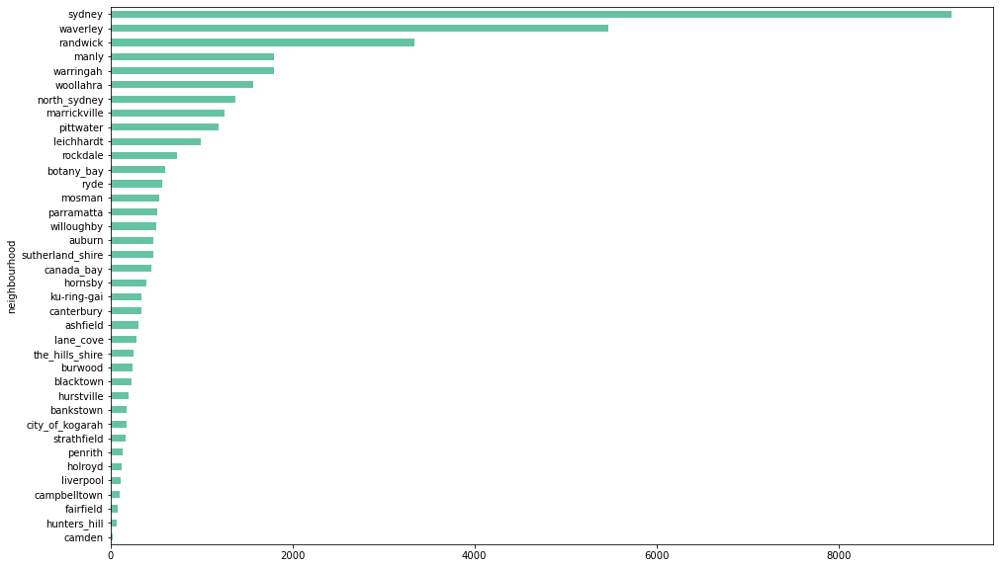

In [81]:
plt.figure(figsize =(16,10))
listing_18.groupby(['neighbourhood'])['id'].count().sort_values().plot.barh()

<AxesSubplot:ylabel='neighbourhood'>

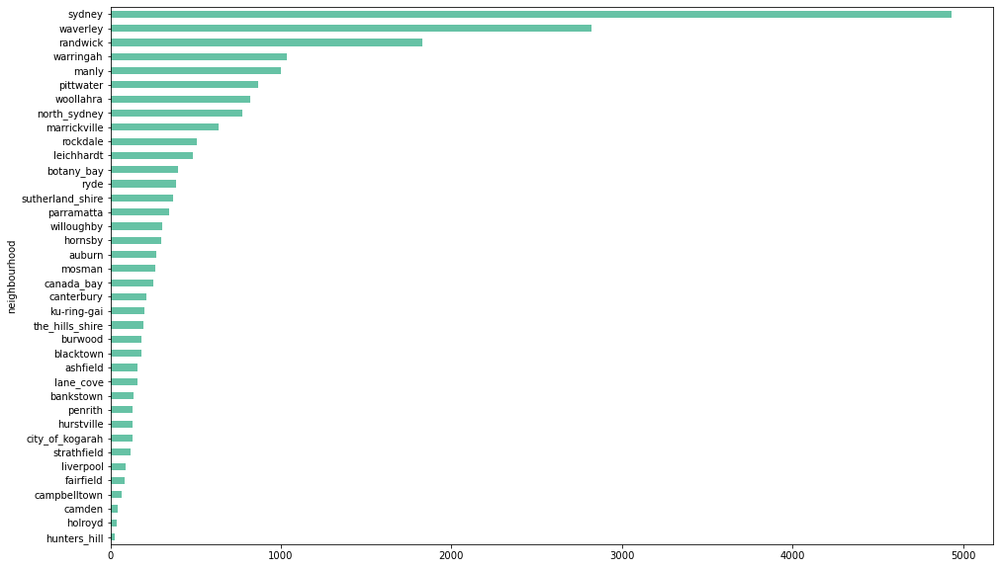

In [82]:
plt.figure(figsize =(16,10))
listing_21.groupby(['neighbourhood'])['id'].count().sort_values().plot.barh()

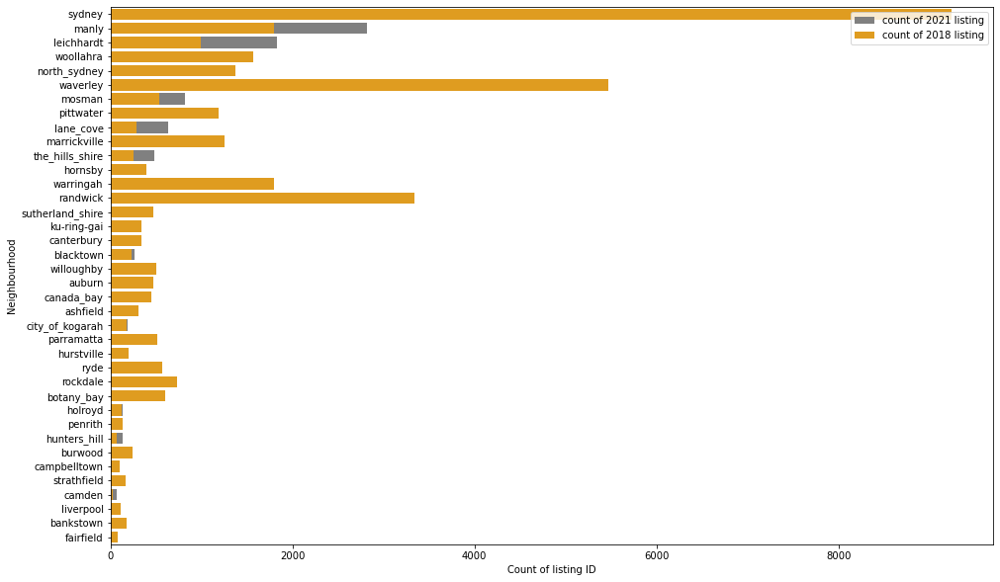

In [83]:
plt.figure(figsize =(16,10))
ax = sns.countplot(data = listing_21,y = listing_21['neighbourhood'], order = listing_21['neighbourhood'].value_counts().index, label = 'count of 2021 listing', color = 'gray')
sns.countplot(data = listing_18, y = listing_18['neighbourhood'], label = 'count of 2018 listing', ax = ax, color = 'orange')
plt.legend(loc = 'upper right')
plt.xlabel('Count of listing ID')
plt.ylabel('Neighbourhood')
plt.show()

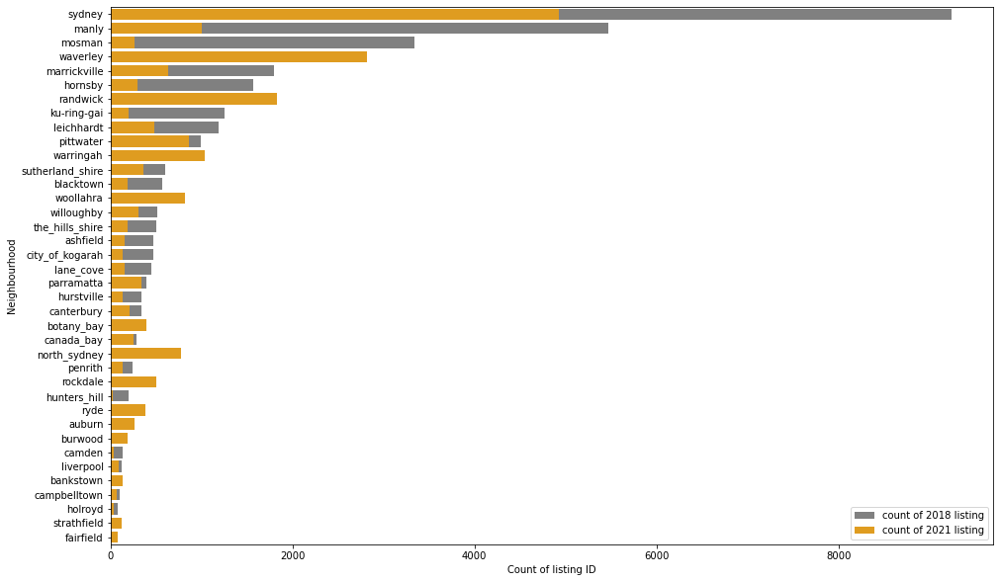

In [84]:
plt.figure(figsize =(16,10))
ax = sns.countplot(data = listing_18,y = listing_18['neighbourhood'], order = listing_18['neighbourhood'].value_counts().index, label = 'count of 2018 listing', color = 'gray')
sns.countplot(data = listing_21, y = listing_21['neighbourhood'], label = 'count of 2021 listing', ax = ax, color = 'orange')
plt.legend(loc = 'lower right')
plt.xlabel('Count of listing ID')
plt.ylabel('Neighbourhood')
plt.show()

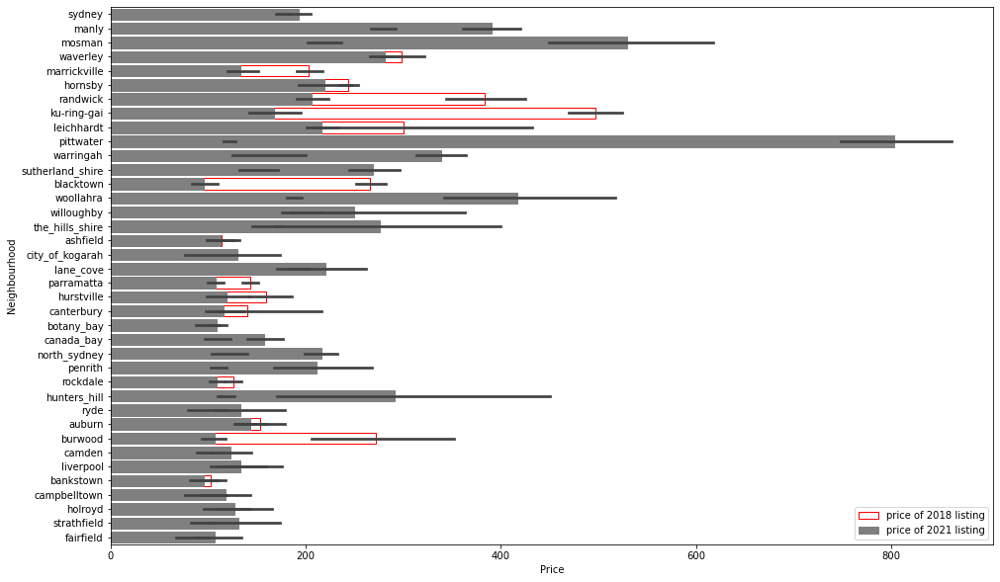

In [125]:
plt.figure(figsize =(16,10))
ax = sns.barplot(x = listing_18['price'],y = listing_18['neighbourhood'], label = 'price of 2018 listing', color = 'white', edgecolor = 'red')
sns.barplot(x = listing_21['price'], y = listing_21['neighbourhood'], label = 'price of 2021 listing', color = 'grey', edgecolor = 'grey')
plt.legend(loc = 'lower right')
plt.xlabel('Price')
plt.ylabel('Neighbourhood')
plt.show()

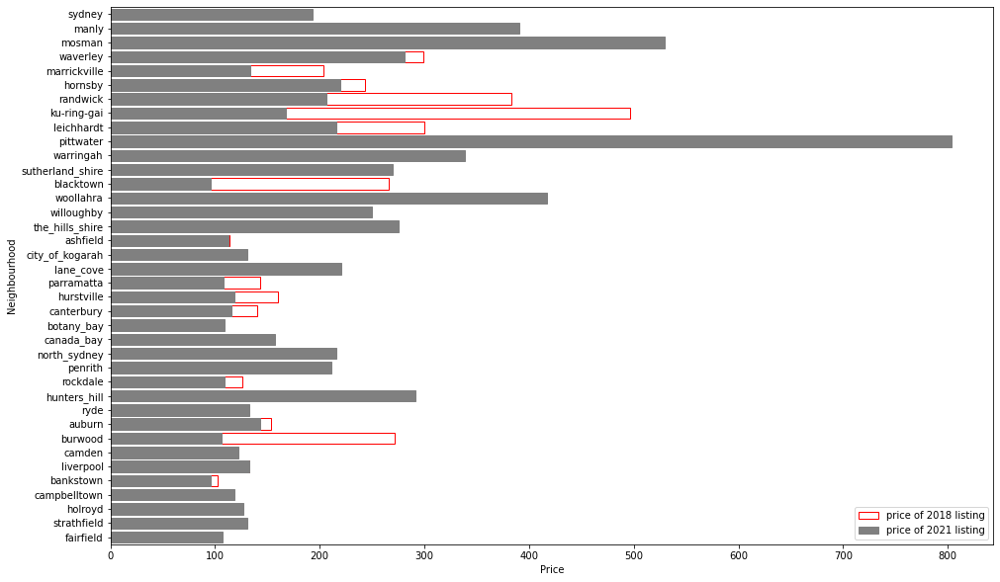

In [128]:
plt.figure(figsize =(16,10))
ax = sns.barplot(x = listing_18['price'],y = listing_18['neighbourhood'], label = 'price of 2018 listing', color = 'white', edgecolor = 'red', ci = None)
sns.barplot(x = listing_21['price'], y = listing_21['neighbourhood'], label = 'price of 2021 listing', color = 'grey', edgecolor = 'grey', ci = None)
plt.legend(loc = 'lower right')
plt.xlabel('Price')
plt.ylabel('Neighbourhood')
plt.show()

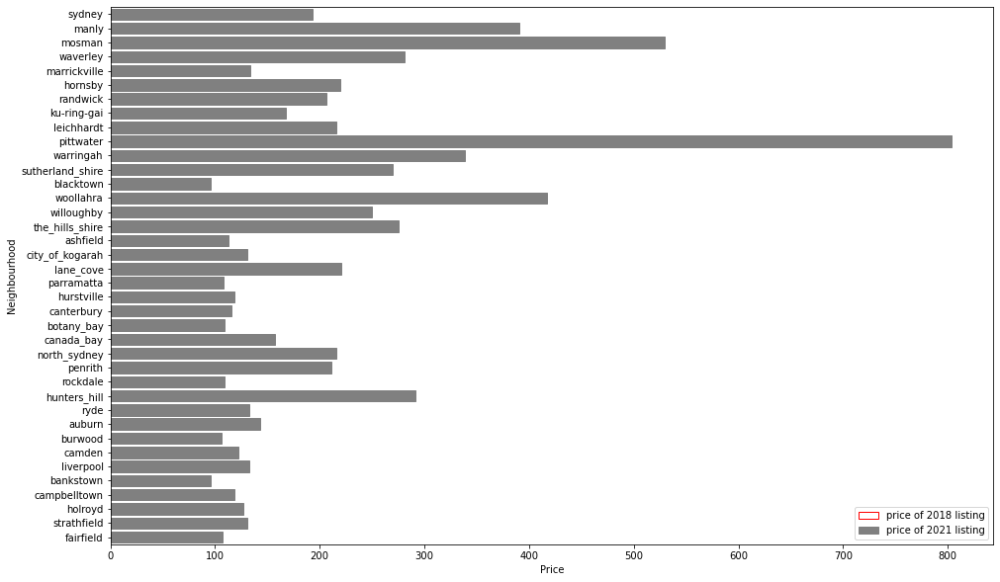

In [129]:
plt.figure(figsize =(16,10))
ax = sns.barplot(x = listing_18['price'],y = listing_18['neighbourhood'], order = listing_18['price'].sort_values().index, label = 'price of 2018 listing', color = 'white', edgecolor = 'red', ci = None)
sns.barplot(x = listing_21['price'], y = listing_21['neighbourhood'], label = 'price of 2021 listing', color = 'grey', edgecolor = 'grey', ci = None)
plt.legend(loc = 'lower right')
plt.xlabel('Price')
plt.ylabel('Neighbourhood')
plt.show()

In [87]:
# assign neighbourhood to regions
def data_region_change(data):
    data.loc[data.neighbourhood == 'sydney', 'Region'] = 'sydney_cbd'
    data.loc[data.neighbourhood == 'pittwater', 'Region'] = 'Northern Beaches'
    data.loc[data.neighbourhood == 'the_hills_shire', 'Region'] = 'Northern West'
    data.loc[data.neighbourhood == 'warringah', 'Region'] = 'Northern Suburbs'
    data.loc[data.neighbourhood == 'sutherland_shire', 'Region'] = 'Southern Suburbs'
    data.loc[data.neighbourhood == 'ku-ring-gai', 'Region'] = 'Northern Suburbs'
    data.loc[data.neighbourhood == 'canada_bay', 'Region'] = 'Inner West'
    data.loc[data.neighbourhood == 'city_of_kogarah', 'Region'] = 'Southern Suburbs'
    data.loc[data.neighbourhood == 'botany_bay', 'Region'] = 'Eastern Suburbs'
    return data

In [88]:
listing_18 = data_region_change(listing_18)
listing_21 = data_region_change(listing_21)

In [89]:
listing_18.head(3)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,availability_perc,Name,Region
0,12351,Sydney City & Harbour at the door,17061,Stuart,sydney,-33.865153,151.191896,Private room,100,2,493,2018-11-21,4.83,2,187,0.512329,NaN,sydney_cbd
1,14250,Manly Harbour House,55948,Heidi,manly,-33.800929,151.261722,Entire home/apt,471,5,1,2016-01-02,0.03,2,321,0.879452,manly,Northern Beaches
2,15253,Stunning Penthouse Apartment In Heart Of The City,59850,Morag,sydney,-33.880455,151.216541,Private room,109,2,300,2018-11-16,3.63,2,316,0.865753,NaN,sydney_cbd


In [90]:
listing_21.head(3)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,availability_perc,Name,Region
0,11156,An Oasis in the City,40855,Colleen,sydney,-33.86767,151.22497,Private room,65,90,196,2020-03-13,1.34,1,364,0,NaN,0.997260,NaN,sydney_cbd
1,14250,Manly Harbour House,55948,Heidi,manly,-33.80084,151.26378,Entire home/apt,470,2,3,2021-06-01,0.04,2,174,1,Exempt,0.476712,manly,Northern Beaches
2,15253,Unique Designer Rooftop Apartment in City Loca...,59850,Morag,sydney,-33.87964,151.21680,Private room,82,2,383,2021-12-03,3.21,1,336,18,PID-STRA-24061-7,0.920548,NaN,sydney_cbd


In [91]:
listing_18.isnull().sum()

id                                    0
name                                 12
host_id                               0
host_name                             6
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       11937
reviews_per_month                 11937
calculated_host_listings_count        0
availability_365                      0
availability_perc                     0
Name                              14523
Region                                0
dtype: int64

In [92]:
listing_21.isnull().sum()

id                                    0
name                                  7
host_id                               0
host_name                             3
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                        5809
reviews_per_month                  5809
calculated_host_listings_count        0
availability_365                      0
number_of_reviews_ltm                 0
license                           13387
availability_perc                     0
Name                               8379
Region                                0
dtype: int64

In [93]:
listing_18.Region.unique()

array(['sydney_cbd', 'Northern Beaches', 'Inner West', 'Eastern Suburbs',
       'Lower North Shore', 'North Shore', 'Northern West',
       'Upper North Shore', 'Northern Suburbs', 'Southern Suburbs',
       'Western Suburbs', 'South West'], dtype=object)

In [94]:
listing_18.Region.nunique()

12

In [95]:
listing_21.Region.unique()

array(['sydney_cbd', 'Northern Beaches', 'North Shore', 'Eastern Suburbs',
       'Inner West', 'Upper North Shore', 'Northern Suburbs',
       'Southern Suburbs', 'Western Suburbs', 'Lower North Shore',
       'Northern West', 'South West'], dtype=object)

In [96]:
# create a region_list to loop over
region_list = listing_21.Region.unique().tolist()
region_list

['sydney_cbd',
 'Northern Beaches',
 'North Shore',
 'Eastern Suburbs',
 'Inner West',
 'Upper North Shore',
 'Northern Suburbs',
 'Southern Suburbs',
 'Western Suburbs',
 'Lower North Shore',
 'Northern West',
 'South West']

In [97]:
N = 100
alpha = 0.05

In [98]:
def print_sig_region(p_value, alpha):
    '''
    Inputs:
    p_value: Calculated p_value
    alpha: Confidence level
    '''
    if p_value < alpha:
        return 'H1'
    elif p_value > alpha:
        return 'H0'
    else:
        return "p_value = alpha"

In [99]:
from scipy import stats

In [100]:
null_hypothesis = {
    'H0': "There is no difference in the price between 2018 listings and 2021 listings",
    'H1': "There is a difference in the price between 2018 listings and 2021 listings."
}

In [101]:

def region_hypotest(data_18, data_21):

    for i in region_list:
        error_list = []
        N  = 100   
        a = listing_18[listing_18['Region'] == i]['price']
        b = listing_21[listing_21['Region'] == i]['price']
        
        if len(a) < N or len(b) < N:
            error_list.append('_'.join([i]))
        else:
            a_t = a.sample(N, random_state = 42)
            b_t = b.sample(N, random_state = 42)
            t, p = stats.ttest_ind(a_t, b_t)
            result = print_sig_region(p, alpha)
            print(i,',', str(result))
                                                 
    print('error_list: ',error_list)

In [102]:
x = region_hypotest(listing_18, listing_21)
x

sydney_cbd , H0
Northern Beaches , H1
North Shore , H1
Eastern Suburbs , H1
Inner West , H0
Upper North Shore , H1
Northern Suburbs , H1
Southern Suburbs , H0
Western Suburbs , H0
Lower North Shore , H0
Northern West , H0
error_list:  ['South West']


In [103]:

def region_hypotest_1(data_18, data_21):

    for i in region_list:
        error_list = []
        N  = 100   
        a = listing_18[listing_18['Region'] == i]['price']
        b = listing_21[listing_21['Region'] == i]['price']
        
        if len(a) < N or len(b) < N:
            error_list.append('_'.join([i]))
        else:
            a_t = a.sample(N, random_state = 42)
            b_t = b.sample(N, random_state = 42)
            t, p = stats.ttest_ind(a_t, b_t)
            result = print_sig_region(p, alpha)
            print(i,',', str(result))
                                                 
    print('error_list: ',error_list)

In [104]:
region_hypotest_1(listing_18, listing_21)

sydney_cbd , H0
Northern Beaches , H1
North Shore , H1
Eastern Suburbs , H1
Inner West , H0
Upper North Shore , H1
Northern Suburbs , H1
Southern Suburbs , H0
Western Suburbs , H0
Lower North Shore , H0
Northern West , H0
error_list:  ['South West']


In [105]:
import numpy as np

In [106]:
H1_list = ['Northern Beaches', 'North Shore', 'Eastern Suburbs','Upper North Shore', 'Northern Suburbs']
listing_21['H_mark'] = np.where(listing_21['Region'].isin(H1_list), 'H1','H0')
listing_21.head(2)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,...,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,availability_perc,Name,Region,H_mark
0,11156,An Oasis in the City,40855,Colleen,sydney,-33.86767,151.22497,Private room,65,90,...,2020-03-13,1.34,1,364,0,NaN,0.997260,NaN,sydney_cbd,H0
1,14250,Manly Harbour House,55948,Heidi,manly,-33.80084,151.26378,Entire home/apt,470,2,...,2021-06-01,0.04,2,174,1,Exempt,0.476712,manly,Northern Beaches,H1


In [107]:
lat = listing_21['latitude']
lon = listing_21['longitude']
H_mark = listing_21['H_mark']
locations = list(zip(lat, lon, H_mark))

map_base = folium.Map(location=[-33.8688, 151.2093],tiles='OpenStreetMap',zoom_start=8) 
FastMarkerCluster(data=locations, callback= True ).add_to(map_base)
map_base

# marker map, too slow to load
lat = listing_21['latitude']
lon = listing_21['longitude']
#H_mark = listing_21['H_mark']
#locations = list(zip(lat, lon, H_mark))
locations = list(zip(lat, lon))

map_base = folium.Map(location=[-33.8688, 151.2093],tiles='OpenStreetMap',zoom_start=8) 

for index,row in listing_21.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']], tooltip=row['neighbourhood']).add_to(map_base)
map_base

In [121]:
lat = listing_21['latitude']
lon = listing_21['longitude']
#H_mark = listing_21['H_mark']
#locations = list(zip(lat, lon, H_mark))
locations = list(zip(lat, lon))

map_base = folium.Map(location=[-33.8688, 151.2093],tiles='OpenStreetMap',zoom_start=8) 
for index, row in listing_21.iterrows():
    if row['H_mark'] == 'H1':
        marker_color = 'darkred'
        fill_color = 'darkred'
    else:
        marker_color = 'orange'
        fill_color = 'lightggrey'

    folium.Circle(location=[row['latitude'], row['longitude']], color = marker_color, fill = True, fill_color = fill_color).add_to(map_base)
map_base

In [117]:
lat = listing_21['latitude']
lon = listing_21['longitude']
locations = list(zip(lat, lon))

map_base = folium.Map(location=[-33.8688, 151.2093],tiles='OpenStreetMap',zoom_start=8) 
FastMarkerCluster(data=locations).add_to(map_base)
map_base

In [ ]:
lat = listing_21['latitude']
lon = listing_21['longitude']
locations = list(zip(lat, lon))

map_base = folium.Map(location=[-33.8688, 151.2093],tiles='CartoDB Positron',zoom_start=8) 
FastMarkerCluster(data=locations).add_to(map_base)
map_base

In [ ]:
map_base

# 7. Does the reviews_per_month has an effect on the price of listings in 2018 ?

In [ ]:
null_hypothesis_5 = {
    'H0': "Reveiws per month has no effect on the price of listings in 2018",
    'H1': "Reveiws per month has an effect on the price of listings in 2018."
}

In [ ]:
listing_18_5 = listing_18[['id', 'price', 'reviews_per_month']]
listing_18_5.info()

In [ ]:
listing_18_5.reviews_per_month.median()

In [ ]:
listing_18_5.reviews_per_month.mean()

In [ ]:
less_reviewspm_price_18 = listing_18_5[listing_18_5['reviews_per_month'] <= 0.81 ]['price'].sample(N, random_state = 42)
more_reviewspm_price_18 = listing_18_5[listing_18_5['reviews_per_month'] > 0.81]['price'].sample(N, random_state = 42)

In [ ]:
ax = sns.distplot(less_reviewspm_price_18, label ='less reviews per month in 2018', kde = False);
sns.distplot(more_reviewspm_price_18 , ax = ax,  label = 'more reives per month in 2018', kde = False);
plt.legend(loc = 'upper right')
plt.xlabel('price')
plt.ylabel('Count')
plt.show();# put on same charts

In [ ]:
t5, p5 = stats.ttest_ind(less_reviewspm_price_18, more_reviewspm_price_18)
print("t = " + str(t5))
print("p = " + str(p5))
print_sig(p5, alpha,null_hypothesis_5)

# 8. Does the reviews_per_month has an effect on the price of listings in 2021 ?

In [ ]:
null_hypothesis_6 = {
    'H0': "Reveiws per month has no effect on the price of listings in 2021",
    'H1': "Reveiws per month has an effect on the price of listings in 2021."
}

In [ ]:
listing_21_5 = listing_21[['id', 'price', 'reviews_per_month']]
listing_21_5.info()

In [ ]:
listing_21_5.reviews_per_month.median()

In [ ]:
listing_21_5.reviews_per_month.mean()

In [ ]:
less_reviewspm_price_21 = listing_21_5[listing_21_5['reviews_per_month'] <= 0.42 ]['price'].sample(N, random_state = 42)
more_reviewspm_price_21 = listing_21_5[listing_21_5['reviews_per_month'] > 0.42]['price'].sample(N, random_state = 42)

In [ ]:
ax = sns.distplot(less_reviewspm_price_21, label ='less reviews per month in 2021', kde = False);
sns.distplot(more_reviewspm_price_21 , ax = ax,  label = 'more reives per month in 2021', kde = False);
plt.legend(loc = 'upper right')
plt.xlabel('price')
plt.ylabel('Count')
plt.show();# put on same charts

In [ ]:
t6, p6 = stats.ttest_ind(less_reviewspm_price_18, more_reviewspm_price_18)
print("t = " + str(t6))
print("p = " + str(p6))
print_sig(p6, alpha,null_hypothesis_6)